In [1]:
%matplotlib inline

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import skimage.io
import skimage.transform
import os

import tensorflow as tf

from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, Conv2DTranspose, concatenate, MaxPooling2D, AveragePooling2D, add, GaussianNoise
from tensorflow.keras.callbacks import LearningRateScheduler
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras.metrics import Recall
from tensorflow.keras.regularizers import l2

In [3]:
MAIN_DIR = "/content/drive/MyDrive/Exam_deep_learning/data"
IMG_HEIGHT = 256
IMG_WIDTH = 256
IMG_CHANNELS = 1

# Brain Tumor segmentation from MRI images using U-Net.

### Author: Pavlin Tsonev

## I. Introduction.

Every year there is more than 18 million people around the world with brain tumors [1]. Threatment of these type of tumors include surgical, chemotherapeutic and radiotherapy methods. One of the most important part of the treatment is determining the boundaries of the tumor and his irradiation during  radiotherapy. This part is important because we want to irradiate only tumor not the healthy part of the brain because this will damage this part. In this task Artificial Intelligence can help us to determine boundaries of the tumor on MRI images.

In diagnostics for these types of tumors it is preferred from doctors to use MRI not CT scans because of the better image quality and zero radiation dose while for CT scans is used X-rays. After diagnostic part if there is tumor has to be done CT scan of the patient which is needed because of the treatment planning and boundaries of the tumor have to be transfered from MRI to CT scan. Determining the boundaries of the tumor from doctor is time consuming and not so easy. I will use MRI images to determine the boundaries of the tumors then to transfer them to CT scan is the easy part because there is immobilization which guarantees the same position of the patient during both scans.

## II. Applying Deep Learning model for determining boundaries of brain tumor.

### 1. Model architecture.

In this work will be used model with classical U-Net architecture which is presented on the image below [2, 3].

<img src="https://drive.google.com/uc?export=view&id=1IX1FV0gx7r-PWK_WaFu-6eIAo-NiB2Q2" width="800"/>

Below is presented the code for building the architecture of the model [4, 5].

In [4]:
def defining_layers_u_net():
    inputs = Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))

    c1 = Conv2D(filters = 16, kernel_size = (3, 3), activation = "relu", padding = "same") (inputs)
    c2 = Conv2D(filters = 16, kernel_size = (3, 3), activation = "relu", padding = "same") (c1)
    mp1 = MaxPooling2D(pool_size = (2, 2)) (c2)

    c3 = Conv2D(filters = 32, kernel_size = (3, 3), activation = "relu", padding = "same") (mp1)
    c4 = Conv2D(filters = 32, kernel_size = (3, 3), activation = "relu", padding = "same") (c3)
    mp2 = MaxPooling2D(pool_size = (2, 2)) (c4)

    c5 = Conv2D(filters = 64, kernel_size = (3, 3), activation = "relu", padding = "same") (mp2)
    c6 = Conv2D(filters = 64, kernel_size = (3, 3), activation = "relu", padding = "same") (c5)
    mp3 = MaxPooling2D(pool_size = (2, 2)) (c6)

    c7 = Conv2D(filters = 128, kernel_size = (3, 3), activation = "relu", padding = "same") (mp3)
    c8 = Conv2D(filters = 128, kernel_size = (3, 3), activation = "relu", padding = "same") (c7)
    mp4 = MaxPooling2D(pool_size = (2, 2)) (c8)

    c9 = Conv2D(filters = 256, kernel_size = (3, 3), activation = "relu", padding = "same") (mp4)
    c10 = Conv2D(filters = 256, kernel_size = (3, 3), activation = "relu", padding = "same") (c9)

    ct1 = Conv2DTranspose(filters = 128, kernel_size = (2, 2), strides=(2, 2), padding="same") (c10)
    u1 = concatenate([ct1, c8])
    c11 = Conv2D(filters = 128, kernel_size = (3, 3), activation = "relu", padding = "same") (u1)
    c12 = Conv2D(filters = 128, kernel_size = (3, 3), activation = "relu", padding = "same") (c11)

    ct2 = Conv2DTranspose(filters = 64, kernel_size = (2, 2), strides = (2, 2), padding = "same") (c12)
    u2 = concatenate([ct2, c6])
    c13 = Conv2D(filters = 64, kernel_size = (3, 3), activation = "relu", padding = "same") (u2)
    c14 = Conv2D(filters = 64, kernel_size = (3, 3), activation = "relu", padding = "same") (c13)

    ct3 = Conv2DTranspose(filters = 32, kernel_size = (2, 2), strides = (2, 2), padding = "same") (c14)
    u3 = concatenate([ct3, c4])
    c15 = Conv2D(filters = 32, kernel_size = (3, 3), activation = "relu", padding = "same") (u3)
    c16 = Conv2D(filters = 32, kernel_size = (3, 3), activation = "relu", padding = "same") (c15)

    ct4 = Conv2DTranspose(filters = 16, kernel_size = (2, 2), strides = (2, 2), padding = "same") (c16)
    u4 = concatenate([ct4, c2], axis = 3)
    c17 = Conv2D(filters = 16, kernel_size = (3, 3), activation = "relu", padding = "same") (u4)
    c18 = Conv2D(filters = 16, kernel_size = (3, 3), activation = "relu", padding = "same") (c17)

    outputs = Conv2D(filters = 1, kernel_size = (1, 1), activation = "sigmoid") (c18)

    u_net_model = Model(inputs = [inputs], outputs = [outputs])

    return u_net_model

In [5]:
u_net_model = defining_layers_u_net()

With this model will be predicted masks only for one type of objects in the images (brain tumors) so for this reason activation function of the output layer is $sigmoid$, loss function which will be used is $binary\_crossentropy$ and for activation function will be used $RMSprop$.

For evaluation of the model will be used $recall$ and $dice\ score$. As we know $recall$ metric answer the question "How many relevant items are selected?". This score will inform us what is the part of the false negative predictions. Formula for calculating $recall$ is presented below.

$recall = \frac{TP}{TP + FN}$

Main metric for evaluation of the model will be $dice\ score$. This is the most used metric for evaluation of segmentation for medical purposes. Formula for calculating the $dice\ score$ is presented below [6].

$dice\_score = \frac{2 TP}{2 TP + FP + FN}$

If we look closer to this formula we will see that $FP + FN + TP$ is actually the union between predicted and real area and if we add one more time $TP$ will give us the sum of the pixels from predicted and real area. And our metric become as follows:

$dice\_score = \frac{2 TP}{predicted + real}$

To use $dice\ score$ as metric for evaluation have to be defined as function which will be passed to metrics when model is fitted.

In [6]:
def dice_score(y_true, y_pred):
    intersection = tf.reduce_sum(y_true * y_pred)
    return (2 * intersection) / (tf.reduce_sum(y_true) + tf.reduce_sum(y_pred))

In [7]:
u_net_model.compile(
    optimizer = RMSprop(learning_rate = 0.001), 
    loss = "binary_crossentropy", 
    metrics = [dice_score, Recall()])

Just to be sure that model architecture is build correctly let's take a quick look at the model summary.

In [8]:
u_net_model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 256, 256, 1) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 256, 256, 16) 160         input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 256, 256, 16) 2320        conv2d[0][0]                     
__________________________________________________________________________________________________
max_pooling2d (MaxPooling2D)    (None, 128, 128, 16) 0           conv2d_1[0][0]                   
______________________________________________________________________________________________

### 2. Preparing and loading the data.

Once the model is created we can move to loading and separation of the images and masks to training, validation, and testing sets.

For this work is used [dataset from Kaggle](https://www.kaggle.com/mateuszbuda/lgg-mri-segmentation) [7] which contains brain MRI scans and masks for each slice for 110 patients.

Images and masks are organized as follows: $"data"$ directory contain directories for each patient and inside these directories are the images and masks of the respective patient.

<img src="https://drive.google.com/uc?export=view&id=1u4MVCnMXZWLQ-3HYRgMvuJJkdLkVg4bm" width="250"/>

If we take a look at the images and masks we can see that in some slicest there is no tumors and masks are just black squares with size $256x256$ pixels as it is shown below. This slices and masks will help to train the model to not predict that there is a tumor for places where is no tumor in other words will help to train the model to recognise healthy tissue and to reduce false positive predictions which will improve it. From one hand it is not so bad to have false positive predictions because this will direct the doctor's attention to this area and will help him to don't miss tumors but from the other hand it is possible this area to be very small, doctor to miss it and after that to irradiate healthy tissue. First let's try to train the model only with images containing tumors.

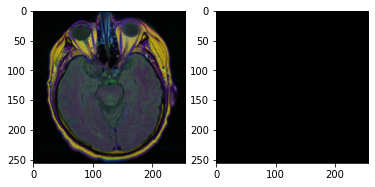

In [9]:
image = skimage.io.imread("/content/drive/MyDrive/Exam_deep_learning/data/TCGA_CS_4941_19960909/TCGA_CS_4941_19960909_10.tif")
mask = skimage.io.imread("/content/drive/MyDrive/Exam_deep_learning/data/TCGA_CS_4941_19960909/TCGA_CS_4941_19960909_10_mask.tif")
plt.subplot(121)
plt.imshow(image, cmap = "gray")
plt.subplot(122)
plt.imshow(mask, cmap = "gray")
plt.show()

To get only images and masks containing tumors we will check all the masks and if there is pixels with values different than zero this means that there is a tumor. Also we can see that images and masks files have the same name with difference that in the name of the mask file there is "_mask" at the end.

Before that let's check what is the shape of the images and masks presented as numpy array to know is there a need to be transformed.

In [10]:
print("Shape of images:", image.shape)
print("Shape of masks:", mask.shape)

Shape of images: (256, 256, 3)
Shape of masks: (256, 256)


We can see that images are with three chanels and need to be readed as grayscale with shape $256x256x1$ for this reason will be used $skimage.io.imread$ to read the images and $as\_gray$ will be setted to $True$ while masks are in grayscale. Also masks have to be transofrmed to shape $256x256x1$.

Now let's check what is the type of data in images and masks.

In [11]:
print("Type of the data in images:", image.dtype)
print("Type of the data in masks:", mask.dtype)

Type of the data in images: uint8
Type of the data in masks: uint8


Type of the data both in images and masks are $uint8$ which means that possible values for pixels is from $0$ to $255$. To normalize pixel values in the range from $0$ to $1$ they myst be devided by $255$.

Usually MRI scans and CT scans are created with $3mm$ step which means that consistent slices represent the anatomy at a distance of $3mm$. This is too small distance to have significantly difference between consistent slices which means that every image will be similar to its adjacent slices which actually decrease the dataset. For this reason will be applied rotation to the images randomly to $0^o$, $90^o$, $180^o$ and $270^o$ and every second image will flipped in left to right direction. This will be applied also to corresponding masks.

For rotation of the images will be used $skimage.transform.rotate$ which will normalize values of the pixels in range between $0$ to $1$ and there is no need to be devided by $255$ as noted earlier.

Size of validation and testing set will be $100$ images and corresponding masks. Despite of applied transformations to images and masks there is still a chance to have images which are similar to others so for validation and testing set they will be chosen randomly from all images and masks.

In [12]:
# define empty lists for images and masks containing tumors
images_with_tumors = []
masks_with_tumors = []

# list with patients directories
patients_dir = os.listdir(MAIN_DIR)

# set counter for files equal to 0
file_counter = 0

# iterate over the files in directories 
# apply transformation to images and masks containing tumors 
# and add them to coresponding list 
for current_patient_dir in patients_dir:
    current_patient_files_name = os.listdir(f"{MAIN_DIR}/{current_patient_dir}")
    for current_file_name in current_patient_files_name:
        if "_mask" in current_file_name:
            current_mask = skimage.io.imread(f"{MAIN_DIR}/{current_patient_dir}/{current_file_name}", )
            if (current_mask != 0).any():
                file_counter += 1
                current_mask = np.reshape(current_mask, (IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
                random_angle = np.random.randint(0, 4) * 90
                current_mask = skimage.transform.rotate(current_mask, random_angle)
                current_image_name = current_file_name.replace("_mask", "")
                current_image = skimage.io.imread(f"{MAIN_DIR}/{current_patient_dir}/{current_image_name}", as_gray = True)
                current_image = np.reshape(current_image, (IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
                current_image = skimage.transform.rotate(current_image, random_angle)
                if file_counter % 2 == 0:
                    current_image = np.fliplr(current_image)
                    current_mask = np.fliplr(current_mask)
                images_with_tumors.append(current_image)
                masks_with_tumors.append(current_mask)
                
images_with_tumors = np.array(images_with_tumors)
masks_with_tumors = np.array(masks_with_tumors)

# separate images and masks to training, validation and testing set
random_indexes = np.random.choice(list(np.arange(0, len(images_with_tumors))), 100, replace = False)
validation_images = images_with_tumors[random_indexes]
validation_masks = masks_with_tumors[random_indexes]
images_with_tumors = np.delete(images_with_tumors, random_indexes, axis = 0)
masks_with_tumors = np.delete(masks_with_tumors, random_indexes, axis = 0)

random_indexes = np.random.choice(list(np.arange(0, len(images_with_tumors))), 100, replace = False)
test_images = images_with_tumors[random_indexes]
test_masks = masks_with_tumors[random_indexes]

train_images = np.delete(images_with_tumors, random_indexes, axis = 0)
train_masks = np.delete(masks_with_tumors, random_indexes, axis = 0)

del images_with_tumors
del masks_with_tumors

Now let's plot a few images and corresponding masks just to be sure that transformations are applied correctly.

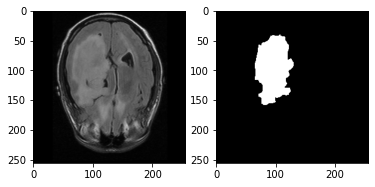

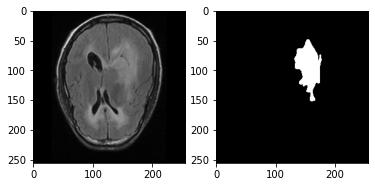

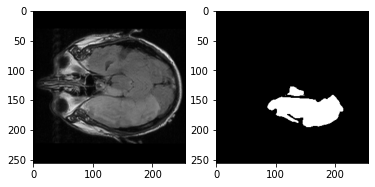

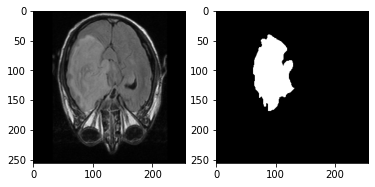

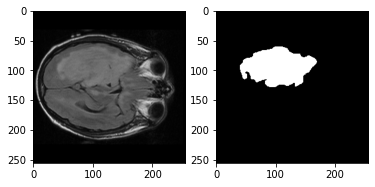

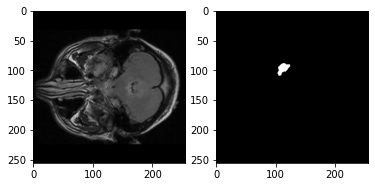

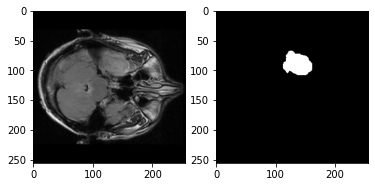

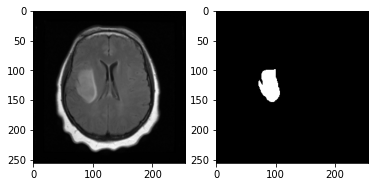

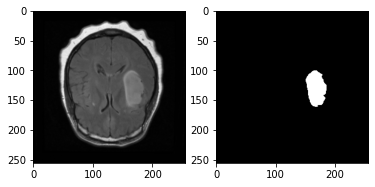

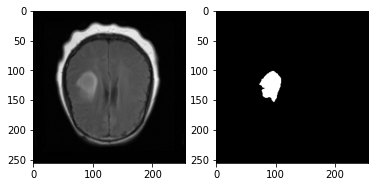

In [13]:
for image_num in range(0, 10):
    plt.subplot(121)
    plt.imshow(train_images[image_num][:, :, 0], cmap="gray")
    plt.subplot(122)
    plt.imshow(train_masks[image_num][:, :, 0], cmap="gray")
    plt.show()

After neural network architecture was created and we have train, validation and testing set we can move to training the model.

### 3. Training the model.

Model will be trained for $50$ epochs and will be used batches with size of $8$ images and corresponding masks also let's use callback to change the learning rate. For first $35$ epochs will train the model with learning rate $0.001$, after that for next $10$ epochs will reduce it to $0.0001$ and last $5$ epochs will be with learning rate equal to $0.00001$. For this purpose will be used $LearningRateScheduler$ from $tensorflow.keras.callbacks$.

First let's define a function for changing learning rate this function will be passed to $LearningRateScheduler$.

In [14]:
def lr_scheduler(epoch, learning_rate):
    if 35 <= epoch < 45:
        learning_rate = 0.0001
    elif epoch >= 45:
        learning_rate = 0.00001
    return learning_rate

In [15]:
callbacks = [LearningRateScheduler(lr_scheduler, verbose = 1)]

Regargless of applied transformations there is still probability to have similar images from consistent slices. For this reason dataset will be shuffled because we don't want to have similar images in batches.

In [16]:
history_u_net = u_net_model.fit(x = train_images, 
                                y = train_masks, 
                                validation_data = (validation_images, validation_masks),
                                batch_size = 8, 
                                epochs = 50,
                                shuffle = True,
                                callbacks = callbacks)

Epoch 1/50

Epoch 00001: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
147/147 [==============================] - 16s 77ms/step - loss: 0.7418 - dice_score: 0.0667 - recall: 0.0296 - val_loss: 0.1249 - val_dice_score: 0.0753 - val_recall: 0.0000e+00
Epoch 2/50

Epoch 00002: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
147/147 [==============================] - 10s 65ms/step - loss: 0.1083 - dice_score: 0.1202 - recall: 0.0000e+00 - val_loss: 0.0756 - val_dice_score: 0.2214 - val_recall: 0.0000e+00
Epoch 3/50

Epoch 00003: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
147/147 [==============================] - 10s 66ms/step - loss: 0.0876 - dice_score: 0.1910 - recall: 0.0000e+00 - val_loss: 0.0746 - val_dice_score: 0.2326 - val_recall: 0.0000e+00
Epoch 4/50

Epoch 00004: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
147/147 [==============================] - 10s 66ms/step - loss: 0.0839

Now let's take a look at the results from training the model and analyze them.

### 4. Analizing results from training the model.

First let's see what is the result from applying $LearningRateScheduler$ and plot loss function from 31 epoch to the end of the training.

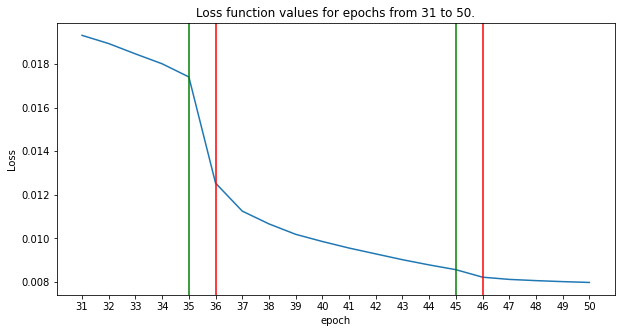

In [17]:
plt.figure(figsize=(10, 5))
plt.plot(history_u_net.history["loss"][30:])
plt.xticks(ticks=range(len(history_u_net.history["loss"][30:])), 
           labels=range(31, len(history_u_net.history["loss"][30:]) + 31))
plt.title("Loss function values for epochs from 31 to 50.")
plt.xlabel("epoch")
plt.ylabel("Loss")
plt.axvline(x = 4, color="green")
plt.axvline(x = 14, color="green")
plt.axvline(x = 5, color="red")
plt.axvline(x = 15, color="red")
plt.show()

Green lines represent last epoch with "old" value for learning rate and red lines represent the first epoch after reducing the learning rate. The effect of reducing the learning rate is obvious.

Now let's take a look at the results for used metrics and loss function values for all epochs.

In [18]:
def plot_loss_and_metrics(history_model, function_to_plot):
    plt.figure(figsize=(25, 10))
    plt.plot(history_model.history[function_to_plot])
    plt.plot(history_model.history[f"val_{function_to_plot}"])
    plt.xticks(ticks=range(len(history_model.history[function_to_plot])), labels = range(1, len(history_model.history[function_to_plot]) + 1))
    plt.title(f"{function_to_plot} values during all epochs.")
    plt.xlabel("epoch")
    plt.ylabel(function_to_plot)
    plt.grid()
    plt.show()

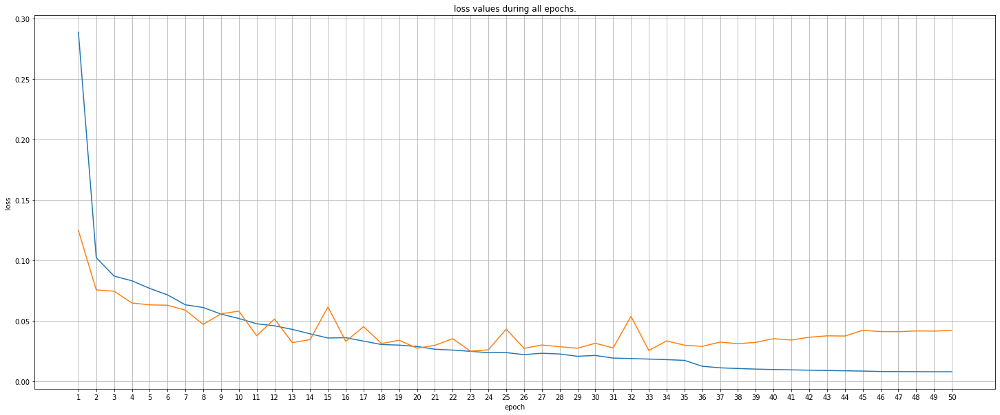

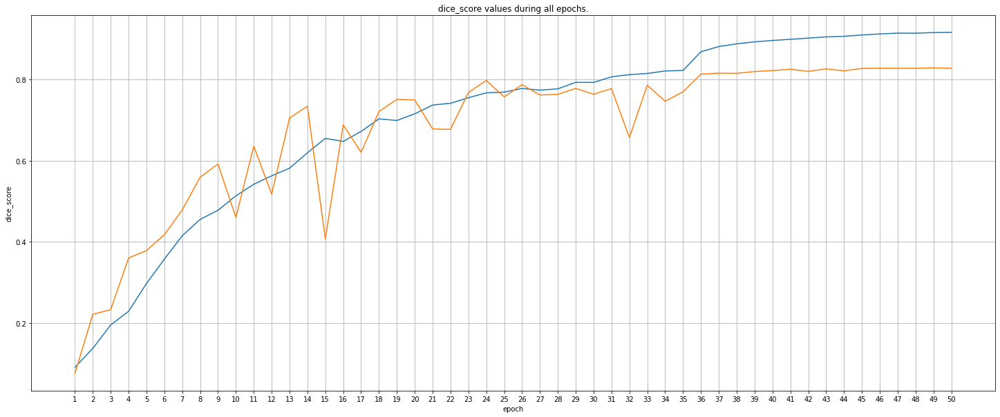

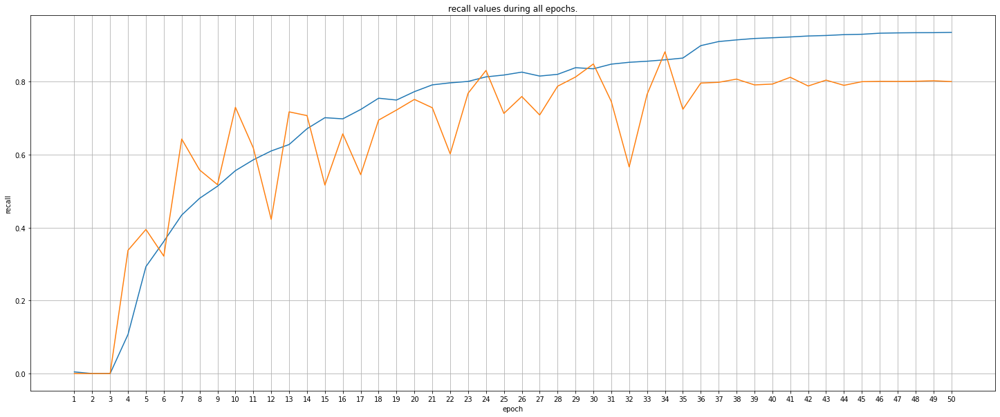

In [19]:
plot_loss_and_metrics(history_u_net, "loss")
plot_loss_and_metrics(history_u_net, "dice_score")
plot_loss_and_metrics(history_u_net, "recall")

After 40th epoch model overfit the data because the validation dice score and recall are the same and loss function even become worst while for training set they become better. Also we can say that model have high variance because of the big difference between values for training and for validation set.

Model return masks with values for each pixel equal to probability (in range from $0$ to $1$ because of the sigmoid function in the output layer) to be part of tumor. For now let's think for pixels with value (probability) great than $0.5$ like pixels predicted as part of the tumor.

Now let's take coordinates of pixels for which model return false negative predictions.

In [20]:
false_negative_areas = (validation_masks - (u_net_model.predict(validation_images) > 0.5).astype(int)) == 1

In [21]:
mask_num, height, width = np.where(false_negative_areas[:, :, :, 0] == 1)

After that we will take values for these pixels but now from MRI images and will plot histogram with them.

In [22]:
false_negative_areas_values = validation_images[mask_num, height, width]

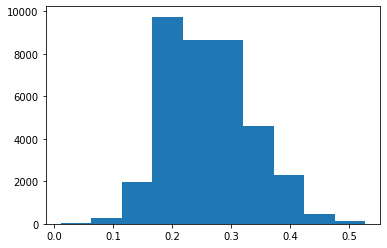

In [23]:
plt.hist(false_negative_areas_values)
plt.show()

This gives us information about values in areas with false negative predictions. We can see that most of the false negative predictions are for pixels with values between $0.1$ and $0.4$. Now let's plot MRI images, also MRI images in binary format where pixels with values between $0.1$ and $0.4$ will be equal to $1$ and others will be equal to $0$, real masks and predicted masks. In this way we can clearly see areas with same values as pixels for which model return false negative predictions.

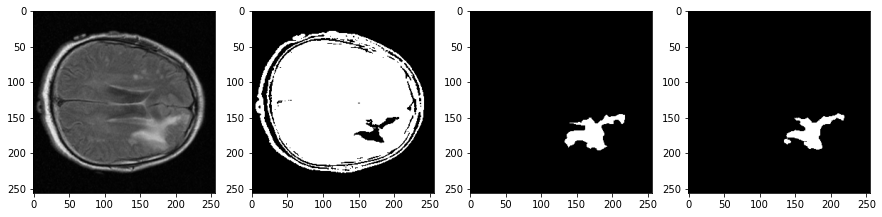

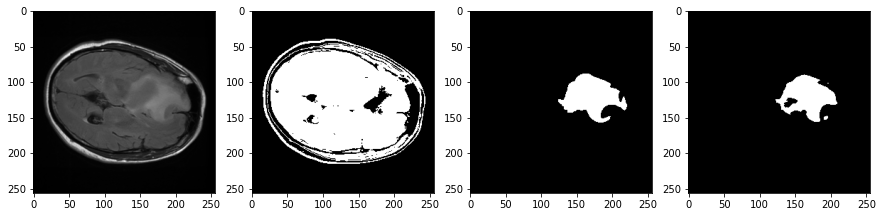

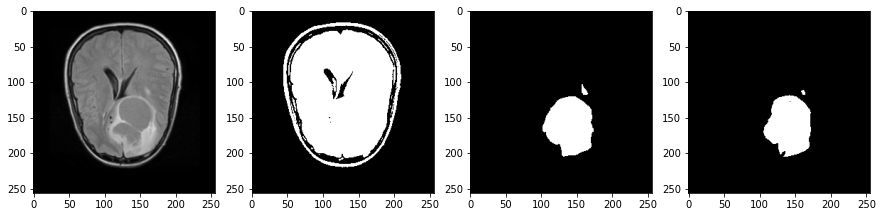

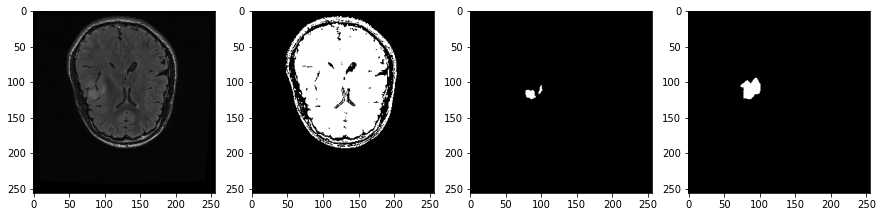

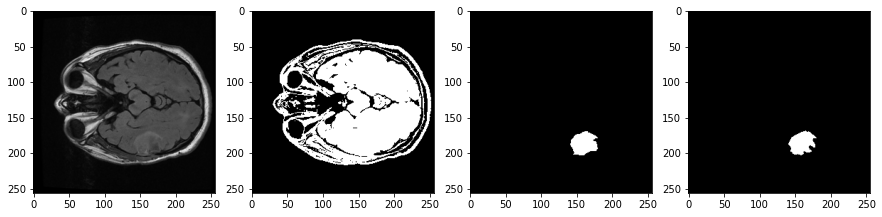

...

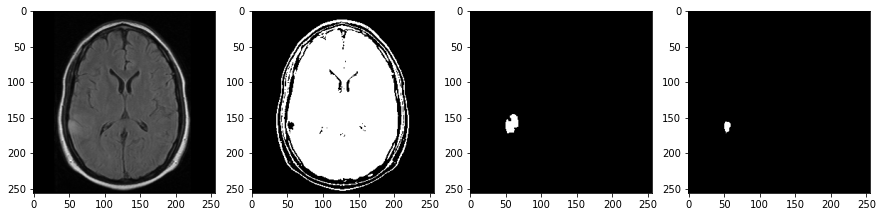

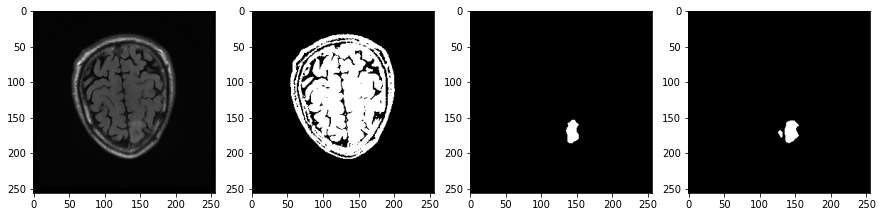

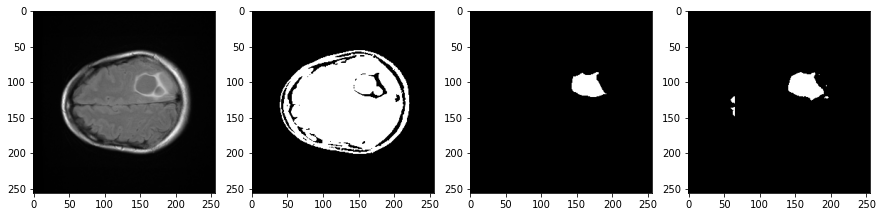

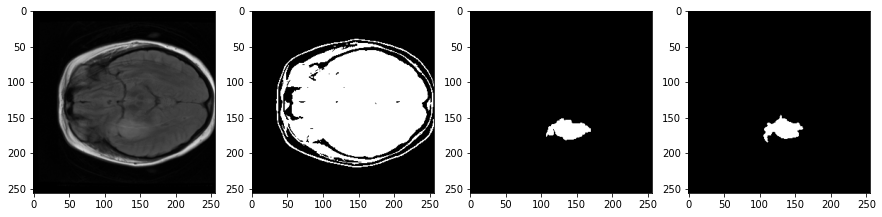

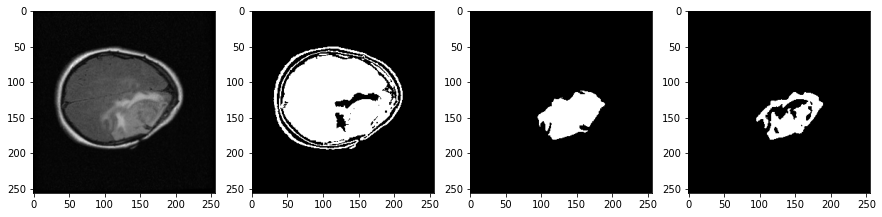

In [24]:
for image_num in range(0, len(validation_images)):
    plt.figure(figsize = (15, 15))
    plt.subplot(141)
    plt.imshow(validation_images[image_num][:, :, 0], cmap = "gray")
    prediction_u_net = u_net_model.predict(np.array([validation_images[image_num]]))
    areas_density_fn = (validation_images[image_num][:, :, 0] < 0.4).astype(int) * (validation_images[image_num][:, :, 0] > 0.1).astype(int)
    plt.subplot(142)
    plt.imshow(areas_density_fn, cmap = "gray")
    plt.subplot(143)
    plt.imshow(validation_masks[image_num][:, :, 0], cmap = "gray")
    plt.subplot(144)
    plt.imshow(prediction_u_net[0][:, :, 0] > 0.5, cmap = "gray")
    plt.show()

From plotted images we see that uncertanties in the predictions of the model come from areas with same value as healthy brain tissue which is expected result.

### 5. Let's try to improve the model.

To handle with overfitting and variance let's add regularization to convolutional layers and noise layer after them. This may help the model in areas where tumor looks like healthy brain tissue. This time model will be trained for 100 epochs and will be used new function for changing the learning rate. First $60$ epochs will be used learning rate equal to $0.001$, for next $25$ epochs $0.0001$ and last epochs will be with learning rate $0.00001$.

In [25]:
def lr_scheduler_reg_noise(epoch, learning_rate):
    if 60 <= epoch < 85:
        learning_rate = 0.0001
    elif epoch >= 85:
        learning_rate = 0.00001
    return learning_rate

In [26]:
 def defining_layers_u_net_with_reg_noise(std_noise, regularizer_value):
    inputs = Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))

    c1 = Conv2D(filters = 16, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same",
                kernel_regularizer=l2(l2 = regularizer_value), 
                bias_regularizer=l2(l2 = regularizer_value)) (inputs)
    n1 = GaussianNoise(std_noise) (c1)
    c2 = Conv2D(filters = 16, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same",
                kernel_regularizer=l2(l2 = regularizer_value), 
                bias_regularizer=l2(l2 = regularizer_value)) (n1)
    n2 = GaussianNoise(std_noise) (c2)
    mp1 = MaxPooling2D(pool_size = (2, 2)) (n2)

    c3 = Conv2D(filters = 32, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same",
                kernel_regularizer=l2(l2 = regularizer_value), 
                bias_regularizer=l2(l2 = regularizer_value)) (mp1)
    n3 = GaussianNoise(std_noise) (c3)
    c4 = Conv2D(filters = 32, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same",
                kernel_regularizer=l2(l2 = regularizer_value), 
                bias_regularizer=l2(l2 = regularizer_value)) (n3)
    n4 = GaussianNoise(std_noise) (c4)
    mp2 = MaxPooling2D(pool_size = (2, 2)) (n4)

    c5 = Conv2D(filters = 64, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same",
                kernel_regularizer=l2(l2 = regularizer_value), 
                bias_regularizer=l2(l2 = regularizer_value)) (mp2)
    n5 = GaussianNoise(std_noise) (c5)
    c6 = Conv2D(filters = 64, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same",
                kernel_regularizer=l2(l2 = regularizer_value), 
                bias_regularizer=l2(l2 = regularizer_value)) (n5)
    n6 = GaussianNoise(std_noise) (c6)
    mp3 = MaxPooling2D(pool_size = (2, 2)) (n6)

    c7 = Conv2D(filters = 128, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same",
                kernel_regularizer=l2(l2 = regularizer_value), 
                bias_regularizer=l2(l2 = regularizer_value)) (mp3)
    n7 = GaussianNoise(std_noise) (c7)
    c8 = Conv2D(filters = 128, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same",
                kernel_regularizer=l2(l2 = regularizer_value), 
                bias_regularizer=l2(l2 = regularizer_value)) (n7)
    n8 = GaussianNoise(std_noise) (c8)
    mp4 = MaxPooling2D(pool_size = (2, 2)) (n8)

    c9 = Conv2D(filters = 256, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same",
                kernel_regularizer=l2(l2 = regularizer_value), 
                bias_regularizer=l2(l2 = regularizer_value)) (mp4)
    n9 = GaussianNoise(std_noise) (c9)
    c10 = Conv2D(filters = 256, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same",
                kernel_regularizer=l2(l2 = regularizer_value), 
                bias_regularizer=l2(l2 = regularizer_value)) (n9)
    n10 = GaussianNoise(std_noise) (c10)

    ct1 = Conv2DTranspose(filters = 128, 
                        kernel_size = (2, 2), 
                        strides=(2, 2), 
                        padding="same") (n10)
    u1 = concatenate([ct1, n8])
    c11 = Conv2D(filters = 128, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same",
                kernel_regularizer=l2(l2 = regularizer_value), 
                bias_regularizer=l2(l2 = regularizer_value)) (u1)
    n11 = GaussianNoise(std_noise) (c11)
    c12 = Conv2D(filters = 128, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same",
                kernel_regularizer=l2(l2 = regularizer_value), 
                bias_regularizer=l2(l2 = regularizer_value)) (n11)
    n12 = GaussianNoise(std_noise) (c12)

    ct2 = Conv2DTranspose(filters = 64, kernel_size = (2, 2), strides = (2, 2), padding = "same") (n12)
    u2 = concatenate([ct2, n6])
    c13 = Conv2D(filters = 64, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same",
                kernel_regularizer=l2(l2 = regularizer_value), 
                bias_regularizer=l2(l2 = regularizer_value)) (u2)
    n13 = GaussianNoise(std_noise) (c13)
    c14 = Conv2D(filters = 64, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same",
                kernel_regularizer=l2(l2 = regularizer_value), 
                bias_regularizer=l2(l2 = regularizer_value)) (n13)
    n14 = GaussianNoise(std_noise) (c14)

    ct3 = Conv2DTranspose(filters = 32, kernel_size = (2, 2), strides = (2, 2), padding = "same") (n14)
    u3 = concatenate([ct3, n4])
    c15 = Conv2D(filters = 32, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same",
                kernel_regularizer=l2(l2 = regularizer_value), 
                bias_regularizer=l2(l2 = regularizer_value)) (u3)
    n15 = GaussianNoise(std_noise) (c15)
    c16 = Conv2D(filters = 32, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same",
                kernel_regularizer=l2(l2 = regularizer_value), 
                bias_regularizer=l2(l2 = regularizer_value)) (n15)
    n16 = GaussianNoise(std_noise) (c16)

    ct4 = Conv2DTranspose(filters = 16, kernel_size = (2, 2), strides = (2, 2), padding = "same") (n16)
    u4 = concatenate([ct4, n2], axis = 3)
    c17 = Conv2D(filters = 16, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same",
                kernel_regularizer=l2(l2 = regularizer_value), 
                bias_regularizer=l2(l2 = regularizer_value)) (u4)
    n17 = GaussianNoise(std_noise) (c17)
    c18 = Conv2D(filters = 16, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same",
                kernel_regularizer=l2(l2 = regularizer_value), 
                bias_regularizer=l2(l2 = regularizer_value)) (n17)
    n18 = GaussianNoise(std_noise) (c18)

    outputs = Conv2D(filters = 1, kernel_size = (1, 1), activation = "sigmoid") (n18)

    u_net_reg_noise = Model(inputs = [inputs], outputs = [outputs])

    return u_net_reg_noise

In [27]:
u_net_reg_noise = defining_layers_u_net_with_reg_noise(0.01, 0.000001)

In [28]:
u_net_reg_noise.compile(
    optimizer = RMSprop(learning_rate = 0.001), 
    loss = "binary_crossentropy", 
    metrics = [dice_score, Recall()])

In [29]:
u_net_reg_noise.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 256, 256, 1) 0                                            
__________________________________________________________________________________________________
conv2d_19 (Conv2D)              (None, 256, 256, 16) 160         input_2[0][0]                    
__________________________________________________________________________________________________
gaussian_noise (GaussianNoise)  (None, 256, 256, 16) 0           conv2d_19[0][0]                  
__________________________________________________________________________________________________
conv2d_20 (Conv2D)              (None, 256, 256, 16) 2320        gaussian_noise[0][0]             
____________________________________________________________________________________________

In [30]:
history_u_net_reg_noise = u_net_reg_noise.fit(x = train_images, 
                                            y = train_masks, 
                                            validation_data = (validation_images, validation_masks),
                                            batch_size = 8, 
                                            epochs = 100,
                                            shuffle = True,
                                            callbacks = [LearningRateScheduler(lr_scheduler_reg_noise, verbose = 1)])

Epoch 1/100

Epoch 00001: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
147/147 [==============================] - 16s 85ms/step - loss: 1.4432 - dice_score: 0.0649 - recall_1: 0.0136 - val_loss: 0.1184 - val_dice_score: 0.1710 - val_recall_1: 0.0000e+00
Epoch 2/100

Epoch 00002: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
147/147 [==============================] - 12s 83ms/step - loss: 0.0966 - dice_score: 0.1511 - recall_1: 0.0000e+00 - val_loss: 0.1182 - val_dice_score: 0.1768 - val_recall_1: 0.0000e+00
Epoch 3/100

Epoch 00003: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
147/147 [==============================] - 12s 83ms/step - loss: 0.0854 - dice_score: 0.1814 - recall_1: 0.0000e+00 - val_loss: 0.1132 - val_dice_score: 0.2201 - val_recall_1: 0.0000e+00
Epoch 4/100

Epoch 00004: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
147/147 [==============================] - 12s 82ms/ste

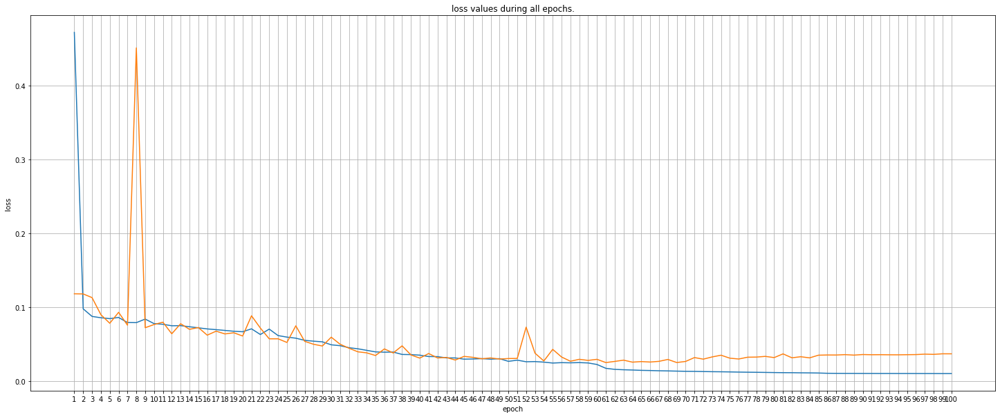

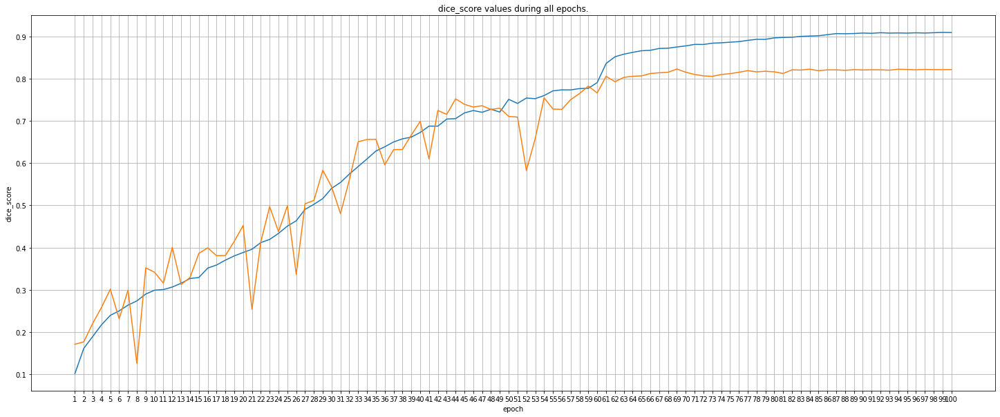

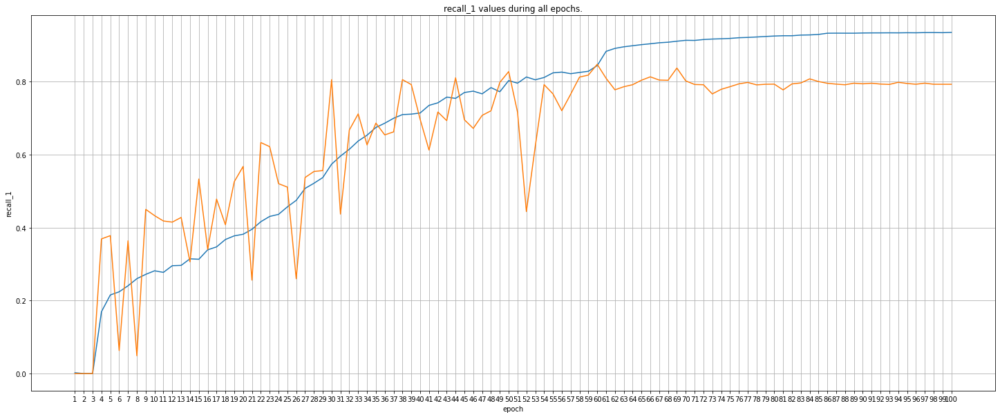

In [31]:
plot_loss_and_metrics(history_u_net_reg_noise, "loss")
plot_loss_and_metrics(history_u_net_reg_noise, "dice_score")
plot_loss_and_metrics(history_u_net_reg_noise, "recall_1")

Model was trained with different values for standart deviation of gausian noise layer and for kernel and bias regularization but at best result was similar or even with higher bias and doesn't reduce variance.

So let's try to change the architecture of the model. Let's add average pooling paralel to max pooling layer after that result from both layers will be multiplied by $0.5$ and will be summed. In this way we will keep information not only for the maximum value from pool size. On figure below it is shown what is the difference with and without using this additional layer.

<img src="images/Fig3.png" width="600"/>

In [32]:
def defining_layers_modified_u_net():
    inputs = Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))

    c1 = Conv2D(filters = 16, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same"
            ) (inputs)
    c2 = Conv2D(filters = 16, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same"
            ) (c1)
    mp1 = MaxPooling2D(pool_size = (2, 2)) (c2)
    ap1 = AveragePooling2D(pool_size = (2, 2)) (c2)
    ap_mp_1 = add([mp1 * 0.5, ap1 * 0.5])

    c3 = Conv2D(filters = 32, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same"
            ) (ap_mp_1)
    c4 = Conv2D(filters = 32, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same"
            ) (c3)
    mp2 = MaxPooling2D(pool_size = (2, 2)) (c4)
    ap2 = AveragePooling2D(pool_size = (2, 2)) (c4)
    ap_mp_2 = add([mp2 * 0.5, ap2 * 0.5])

    c5 = Conv2D(filters = 64, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same"
            ) (ap_mp_2)
    c6 = Conv2D(filters = 64, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same"
            ) (c5)
    mp3 = MaxPooling2D(pool_size = (2, 2)) (c6)
    ap3 = AveragePooling2D(pool_size = (2, 2)) (c6)
    ap_mp_3 = add([mp3 * 0.5, ap3 * 0.5])

    c7 = Conv2D(filters = 128, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same"
            ) (ap_mp_3)
    c8 = Conv2D(filters = 128, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same"
            ) (c7)
    mp4 = MaxPooling2D(pool_size = (2, 2)) (c8)
    ap4 = AveragePooling2D(pool_size = (2, 2)) (c8)
    ap_mp_4 = add([mp4 * 0.5, ap4 * 0.5])

    c9 = Conv2D(filters = 256, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same"
            ) (ap_mp_4)
    c10 = Conv2D(filters = 256, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same"
                ) (c9)

    ct1 = Conv2DTranspose(filters = 128, 
                        kernel_size = (2, 2), 
                        strides = (2, 2), 
                        padding = "same"
                        ) (c10)
    u1 = concatenate([ct1, c8 * 1.5])
    c11 = Conv2D(filters = 128, 
                kernel_size = (3, 3),
                activation = "relu", 
                padding = "same"
                ) (u1)
    c12 = Conv2D(filters = 128, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same"
                ) (c11)

    ct2 = Conv2DTranspose(filters = 64, 
                        kernel_size = (2, 2), 
                        strides = (2, 2), 
                        padding = "same"
                        ) (c12)
    u2 = concatenate([ct2, c6 * 1.5])
    c13 = Conv2D(filters = 64, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same"
                ) (u2)
    c14 = Conv2D(filters = 64, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same"
                ) (c13)

    ct3 = Conv2DTranspose(filters = 32, 
                        kernel_size = (2, 2), 
                        strides = (2, 2), 
                        padding = "same"
                        ) (c14)
    u3 = concatenate([ct3, c4 * 1.5])
    c15 = Conv2D(filters = 32, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same"
                ) (u3)
    c16 = Conv2D(filters = 32, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same"
                ) (c15)

    ct4 = Conv2DTranspose(filters = 16, 
                        kernel_size = (2, 2), 
                        strides = (2, 2), 
                        padding = "same"
                        ) (c16)
    u4 = concatenate([ct4, c2 * 1.5], axis = 3)
    c17 = Conv2D(filters = 16, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same"
                ) (u4)
    c18 = Conv2D(filters = 16, 
                kernel_size = (3, 3), 
                activation = "relu", 
                padding = "same"
                ) (c17)

    outputs = Conv2D(filters = 1, kernel_size = (1, 1), activation = "sigmoid") (c18)

    modified_u_net = Model(inputs = [inputs], outputs = [outputs])

    return modified_u_net

In [33]:
modified_u_net = defining_layers_modified_u_net()

In [34]:
modified_u_net.compile(
    optimizer = RMSprop(learning_rate = 0.001), 
    loss = "binary_crossentropy", 
    metrics = [dice_score, Recall()])

In [35]:
modified_u_net.summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 256, 256, 1) 0                                            
__________________________________________________________________________________________________
conv2d_38 (Conv2D)              (None, 256, 256, 16) 160         input_3[0][0]                    
__________________________________________________________________________________________________
conv2d_39 (Conv2D)              (None, 256, 256, 16) 2320        conv2d_38[0][0]                  
__________________________________________________________________________________________________
max_pooling2d_8 (MaxPooling2D)  (None, 128, 128, 16) 0           conv2d_39[0][0]                  
____________________________________________________________________________________________

In [36]:
history_modified_u_net = modified_u_net.fit(x = train_images, 
                                            y = train_masks, 
                                            validation_data = (validation_images, validation_masks),
                                            batch_size = 8, 
                                            epochs = 50,
                                            shuffle = True,
                                            callbacks = callbacks)

Epoch 1/50

Epoch 00001: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
147/147 [==============================] - 13s 76ms/step - loss: 0.7914 - dice_score: 0.0633 - recall_2: 0.0000e+00 - val_loss: 0.0899 - val_dice_score: 0.1266 - val_recall_2: 0.0000e+00
Epoch 2/50

Epoch 00002: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
147/147 [==============================] - 11s 73ms/step - loss: 0.0955 - dice_score: 0.1596 - recall_2: 0.0000e+00 - val_loss: 0.0735 - val_dice_score: 0.2638 - val_recall_2: 0.0000e+00
Epoch 3/50

Epoch 00003: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
147/147 [==============================] - 11s 73ms/step - loss: 0.0844 - dice_score: 0.2156 - recall_2: 0.0204 - val_loss: 0.0712 - val_dice_score: 0.2696 - val_recall_2: 0.2114
Epoch 4/50

Epoch 00004: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
147/147 [==============================] - 11s 73ms/step - loss

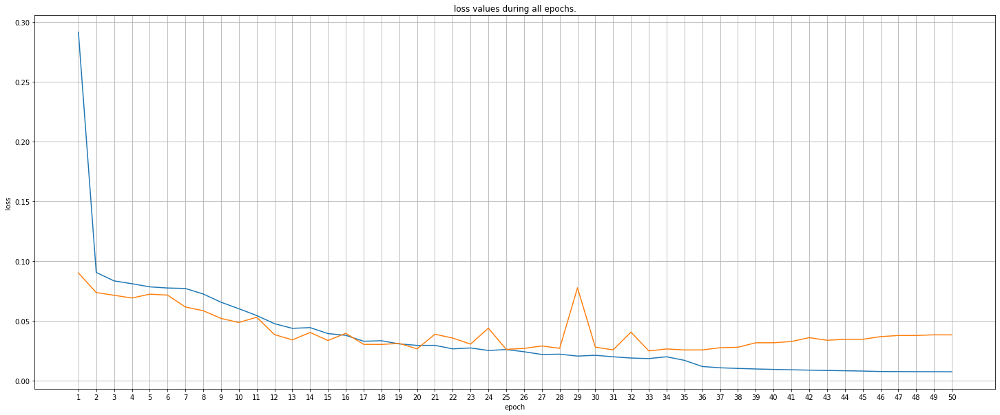

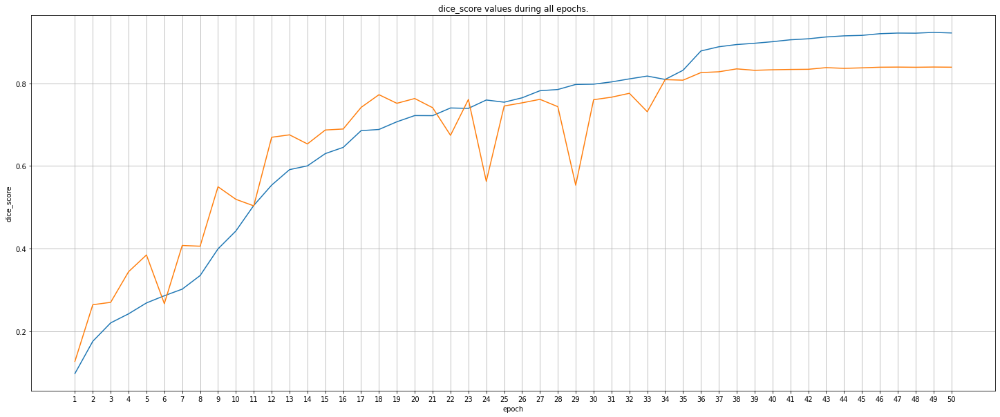

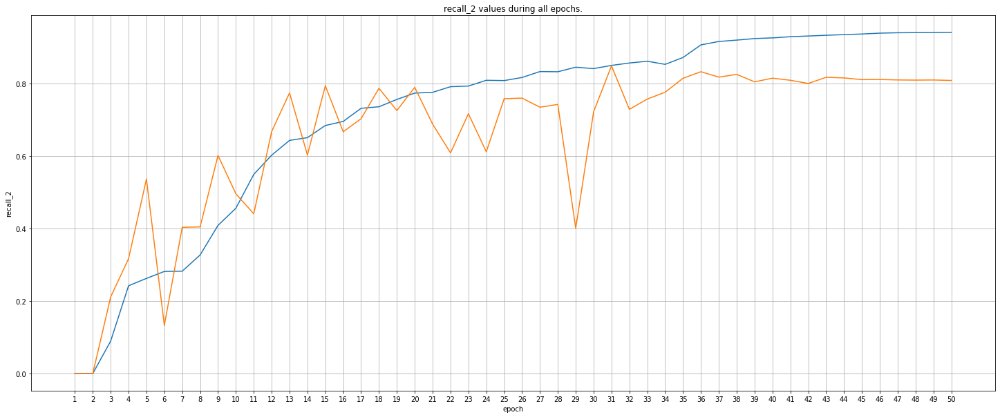

In [37]:
plot_loss_and_metrics(history_modified_u_net, "loss")
plot_loss_and_metrics(history_modified_u_net, "dice_score")
plot_loss_and_metrics(history_modified_u_net, "recall_2")

Changes in the architecture of the model also doesn't help to reduce variance and to handle with overfitting. It seems like we need more data so let's load images without tumors and use them to reduce false negative predictions and in this way to improve dice score and recall metrics. Number of these images will be equal to the images with tumors. But before that we will plot histograms containing prediction probabilities for pixels from real masks which are part of the tumors and histogram for these pixels which are not and will see how sure the models are in their predictions. In this way we will decide which one to use after that for training with the new extended dataset.

First let's predict masks with different models.

In [38]:
prediction_u_net = u_net_model.predict(validation_images)
prediction_u_net_reg_noise = u_net_reg_noise.predict(validation_images)
prediction_modified_u_net = modified_u_net.predict(validation_images)

After that take coordinates from real masks of pixels containing tumors.

In [39]:
mask_num, height, width = np.where(validation_masks[:, :, :, 0] == 1)

And finaly save probabilities for these pixels for each model in lists and will plot histograms first separately.

In [40]:
probabilities_u_net = prediction_u_net[mask_num, height, width]
probabilities_u_net_reg_noise = prediction_u_net_reg_noise[mask_num, height, width]
probabilities_modified_u_net = prediction_modified_u_net[mask_num, height, width]

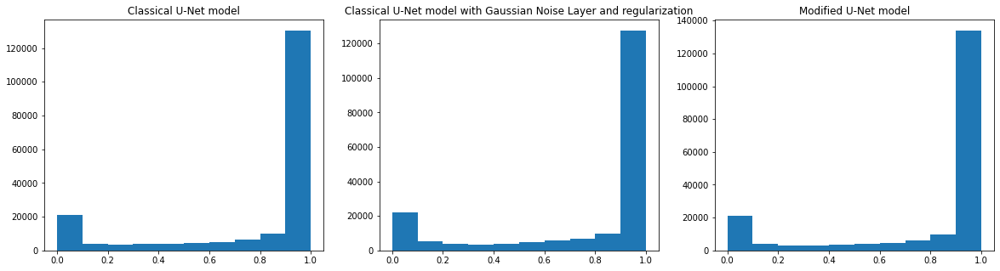

In [41]:
plt.figure(figsize = (20, 5))
plt.subplot(131)
plt.hist(probabilities_u_net)
plt.title("Classical U-Net model")
plt.subplot(132)
plt.hist(probabilities_u_net_reg_noise)
plt.title("Classical U-Net model with Gaussian Noise Layer and regularization")
plt.subplot(133)
plt.hist(probabilities_modified_u_net)
plt.title("Modified U-Net model")
plt.show()

It is obvious that second model in which is used noise layer and regularization is not the best solution. Other two models return similar results so let's plot their histograms in one graph.

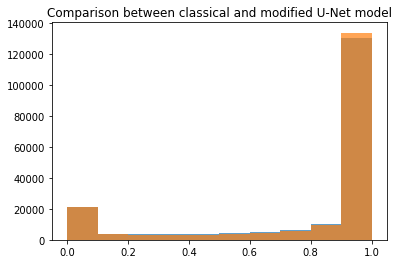

In [42]:
plt.hist(probabilities_u_net, alpha = 0.7)
plt.hist(probabilities_modified_u_net, alpha = 0.7)
plt.title("Comparison between classical and modified U-Net model")
plt.show()

Modified U-Net model return more pixels with probabilities between $0.9$ to $1$. To be sure that modified architecture is better let's plot same histogram but for pixels from real masks where is no tumor.

In [43]:
mask_num, height, width = np.where(validation_masks[:, :, :, 0] == 0)

Just because it is expected to have significantly more pixels with probabilities between $0$ and $0.1$ let's plot on histogram number of pixels with values great than $0.1$ and print number of pixels with values between $0$ and $0.1$.

In [44]:
probabilities_u_net = prediction_u_net[mask_num, height, width][prediction_u_net[mask_num, height, width] > 0.1]
probabilities_modified_u_net = prediction_modified_u_net[mask_num, height, width][prediction_modified_u_net[mask_num, height, width] > 0.1]

In [45]:
print("Number of pixels with values less than 0.1 according to classical U-Net model:",
      len(prediction_u_net[mask_num, height, width][prediction_u_net[mask_num, height, width] < 0.1]))
print("Number of pixels with values less than 0.1 according to modified U-Net model:", 
      len(prediction_modified_u_net[mask_num, height, width][prediction_modified_u_net[mask_num, height, width] < 0.1]))

Number of pixels with values less than 0.1 according to classical U-Net model: 6312425
Number of pixels with values less than 0.1 according to modified U-Net model: 6318165


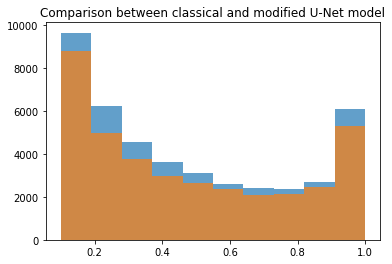

In [46]:
plt.hist(probabilities_u_net, alpha = 0.7)
plt.hist(probabilities_modified_u_net, alpha = 0.7)
plt.title("Comparison between classical and modified U-Net model")
plt.show()

Modified U-Net architecture return more pixels with values between $0$ and $0.1$ and less pixels with value higher than $0.5$ so this model is a little bit better and will be trained with new extended dataset.

And now we can move to loading images and masks as was explained above and train modified U-Net model.

In [47]:
# define empty lists for images and masks which doesn't contain tumors
images_without_tumors = []
masks_without_tumors = []

# list with patients directories
file_counter = 0

# iterate over the files in directories 
# apply transformation to images and masks which doesn't contain tumors 
# and add them to coresponding list 
for current_patient_dir in patients_dir:
    if file_counter >= len(train_images) + len(validation_images) + len(test_images):
        break
    current_patient_files_name = os.listdir(f"{MAIN_DIR}/{current_patient_dir}")
    for current_file_name in current_patient_files_name:
        if "_mask" in current_file_name:
            current_mask = skimage.io.imread(f"{MAIN_DIR}/{current_patient_dir}/{current_file_name}")
            if (current_mask == 0).all():
                file_counter += 1
                if file_counter <= len(train_images) + len(validation_images) + len(test_images):
                    current_mask = np.reshape(current_mask, (IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
                    random_angle = np.random.randint(0, 4) * 90
                    current_mask = skimage.transform.rotate(current_mask, random_angle)
                    current_image_name = current_file_name.replace("_mask", "")
                    current_image = skimage.io.imread(f"{MAIN_DIR}/{current_patient_dir}/{current_image_name}", as_gray = True)
                    current_image = np.reshape(current_image, (IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
                    current_image = skimage.transform.rotate(current_image, random_angle)
                    if file_counter % 2 == 0:
                        current_image = np.fliplr(current_image)
                        current_mask = np.fliplr(current_mask)
                    images_without_tumors.append(current_image)
                    masks_without_tumors.append(current_mask)
                else:
                    break

images_without_tumors = np.array(images_without_tumors)
masks_without_tumors = np.array(masks_without_tumors)

# separate images and masks without tumors and add them to already created training, validation and testing set
random_indexes = np.random.choice(list(np.arange(0, len(images_without_tumors))), 100, replace = False)
validation_images = np.append(validation_images, images_without_tumors[random_indexes], axis = 0)
validation_masks = np.append(validation_masks, masks_without_tumors[random_indexes], axis = 0)

images_without_tumors = np.delete(images_without_tumors, random_indexes, axis = 0)
masks_without_tumors = np.delete(masks_without_tumors, random_indexes, axis = 0)

random_indexes = np.random.choice(list(np.arange(0, len(images_without_tumors))), 100, replace = False)
test_images = np.append(test_images, images_without_tumors[random_indexes], axis = 0)
test_masks = np.append(test_masks, masks_without_tumors[random_indexes], axis = 0)

train_images = np.append(train_images, np.delete(images_without_tumors, random_indexes, axis = 0), axis = 0)
train_masks = np.append(train_masks, np.delete(masks_without_tumors, random_indexes, axis = 0), axis = 0)

del images_without_tumors
del masks_without_tumors

In [48]:
modified_u_net_ext_data = defining_layers_modified_u_net()

In [49]:
modified_u_net_ext_data.compile(
    optimizer = RMSprop(learning_rate = 0.001), 
    loss = "binary_crossentropy", 
    metrics = [dice_score, Recall()])

In [50]:
history_modified_u_net_ext_data = modified_u_net_ext_data.fit(x = train_images, 
                                y = train_masks, 
                                validation_data = (validation_images, validation_masks),
                                batch_size = 8, 
                                epochs = 50,
                                shuffle = True,
                                callbacks = callbacks)

Epoch 1/50

Epoch 00001: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
294/294 [==============================] - 25s 76ms/step - loss: 0.1666 - dice_score: 0.0565 - recall_3: 3.1981e-05 - val_loss: 0.0469 - val_dice_score: 0.0728 - val_recall_3: 0.0000e+00
Epoch 2/50

Epoch 00002: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
294/294 [==============================] - 22s 73ms/step - loss: 0.0553 - dice_score: 0.1235 - recall_3: 7.4570e-05 - val_loss: 0.0492 - val_dice_score: 0.1192 - val_recall_3: 0.0707
Epoch 3/50

Epoch 00003: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
294/294 [==============================] - 21s 72ms/step - loss: 0.1285 - dice_score: 0.1560 - recall_3: 0.1476 - val_loss: 0.0398 - val_dice_score: 0.1486 - val_recall_3: 0.2032
Epoch 4/50

Epoch 00004: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
294/294 [==============================] - 21s 71ms/step - loss: 0.

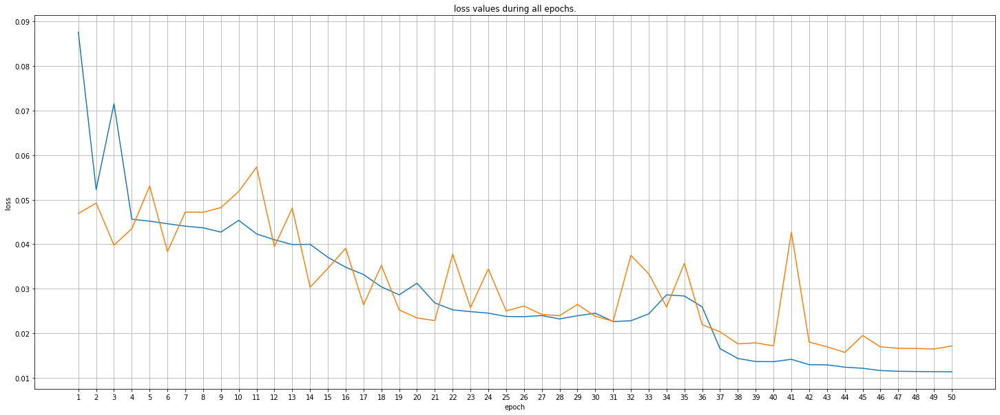

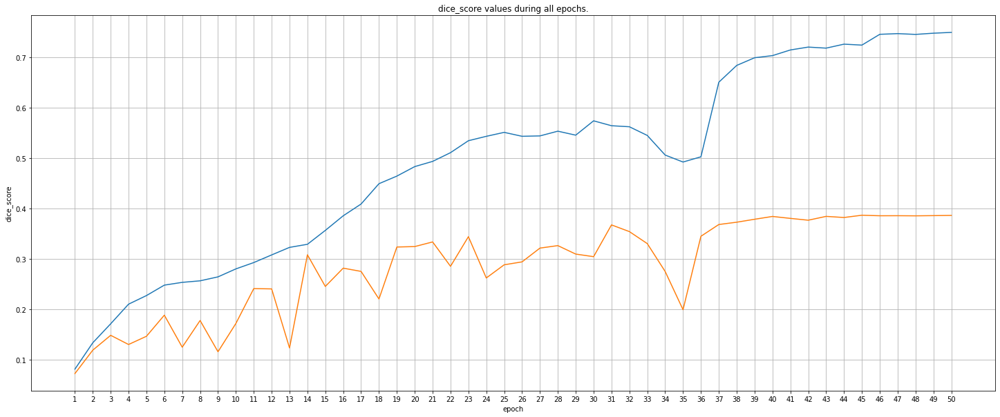

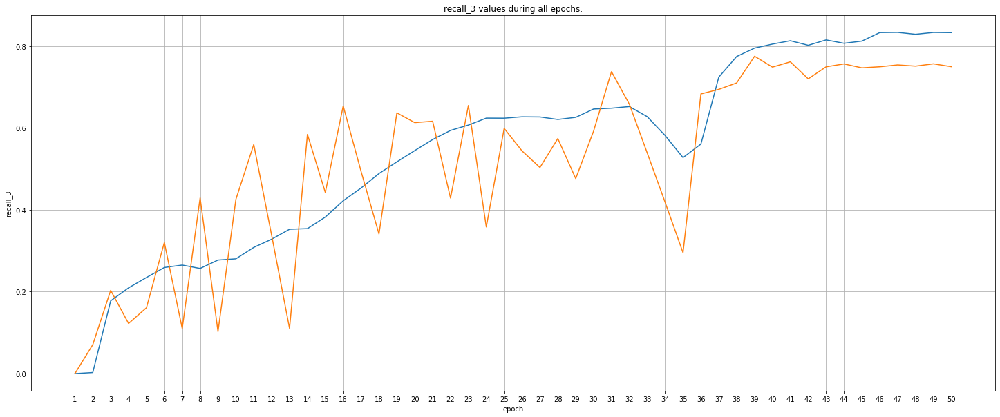

In [51]:
plot_loss_and_metrics(history_modified_u_net_ext_data, "loss")
plot_loss_and_metrics(history_modified_u_net_ext_data, "dice_score")
plot_loss_and_metrics(history_modified_u_net_ext_data, "recall_3")

Using images and masks without tumors for training the model reduce variance for recall metric but increase variance for dice score a lot. So next thing which we will try is to use only images containing tumors but this time they will be loaded twice first time as at the beggining and second time we will load the same data but this time will flip not even images but odd ones and also will rotate them randomly in this way we will receive more diverse and bigger dataset and will train again modified U-Net model.

In [52]:
del train_images, train_masks, validation_images, validation_masks, test_images, test_masks

In [53]:
# define empty lists for images and masks containing tumors
images_with_tumors = []
masks_with_tumors = []

# list with patients directories
patients_dir = os.listdir(MAIN_DIR)

# list with patients directories
file_counter = 0

# iterate over the files in directories 
# apply transformation to images and masks containing tumors 
# and add them to coresponding list two times as described above
for devision_remainder in range(0, 2):
    for current_patient_dir in patients_dir:
        current_patient_files_name = os.listdir(f"{MAIN_DIR}/{current_patient_dir}")
        for current_file_name in current_patient_files_name:
            if "_mask" in current_file_name:
                current_mask = skimage.io.imread(f"{MAIN_DIR}/{current_patient_dir}/{current_file_name}", )
                if (current_mask != 0).any():
                    file_counter += 1
                    current_mask = np.reshape(current_mask, (IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
                    random_angle = np.random.randint(0, 4) * 90
                    current_mask = skimage.transform.rotate(current_mask, random_angle)
                    current_image_name = current_file_name.replace("_mask", "")
                    current_image = skimage.io.imread(f"{MAIN_DIR}/{current_patient_dir}/{current_image_name}", as_gray = True)
                    current_image = np.reshape(current_image, (IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
                    current_image = skimage.transform.rotate(current_image, random_angle)
                    if file_counter % 2 == devision_remainder:
                        current_image = np.fliplr(current_image)
                        current_mask = np.fliplr(current_mask)
                    images_with_tumors.append(current_image)
                    masks_with_tumors.append(current_mask)
                
images_with_tumors = np.array(images_with_tumors)
masks_with_tumors = np.array(masks_with_tumors)

# separate images and masks to training, validation and testing set
random_indexes = np.random.choice(list(np.arange(0, len(images_with_tumors))), 200, replace = False)
validation_images = images_with_tumors[random_indexes]
validation_masks = masks_with_tumors[random_indexes]
images_with_tumors = np.delete(images_with_tumors, random_indexes, axis = 0)
masks_with_tumors = np.delete(masks_with_tumors, random_indexes, axis = 0)

random_indexes = np.random.choice(list(np.arange(0, len(images_with_tumors))), 200, replace = False)
test_images = images_with_tumors[random_indexes]
test_masks = masks_with_tumors[random_indexes]

train_images = np.delete(images_with_tumors, random_indexes, axis = 0)
train_masks = np.delete(masks_with_tumors, random_indexes, axis = 0)

del images_with_tumors
del masks_with_tumors

In [54]:
modified_u_net_ext_data = defining_layers_modified_u_net()

In [55]:
modified_u_net_ext_data.compile(
    optimizer = RMSprop(learning_rate = 0.001), 
    loss = "binary_crossentropy", 
    metrics = [dice_score, Recall()])

In [56]:
history_modified_u_net_ext_data = modified_u_net_ext_data.fit(x = train_images, 
                                y = train_masks, 
                                validation_data = (validation_images, validation_masks),
                                batch_size = 8, 
                                epochs = 50,
                                shuffle = True,
                                callbacks = callbacks)

Epoch 1/50

Epoch 00001: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
294/294 [==============================] - 24s 74ms/step - loss: 0.2669 - dice_score: 0.0930 - recall_4: 0.0197 - val_loss: 0.0772 - val_dice_score: 0.1658 - val_recall_4: 0.0000e+00
Epoch 2/50

Epoch 00002: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
294/294 [==============================] - 22s 73ms/step - loss: 0.0854 - dice_score: 0.2034 - recall_4: 0.0000e+00 - val_loss: 0.0808 - val_dice_score: 0.2289 - val_recall_4: 0.0000e+00
Epoch 3/50

Epoch 00003: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
294/294 [==============================] - 21s 72ms/step - loss: 0.0779 - dice_score: 0.2401 - recall_4: 0.0982 - val_loss: 0.0667 - val_dice_score: 0.2945 - val_recall_4: 0.2766
Epoch 4/50

Epoch 00004: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
294/294 [==============================] - 21s 72ms/step - loss: 0.

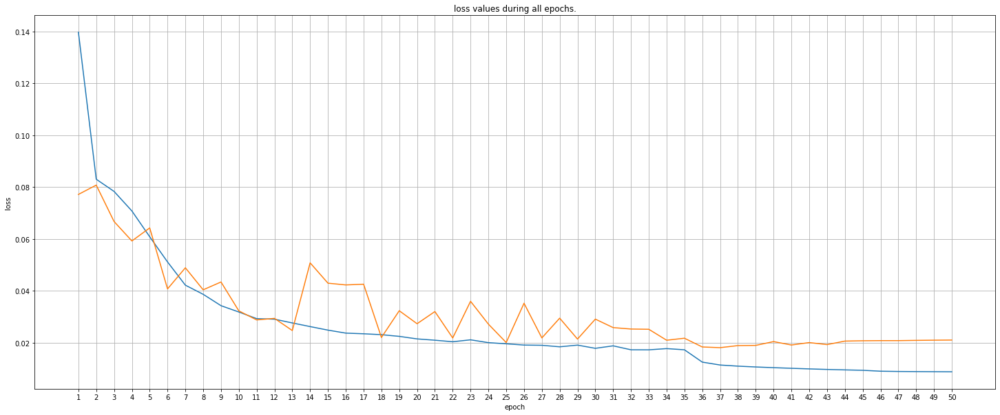

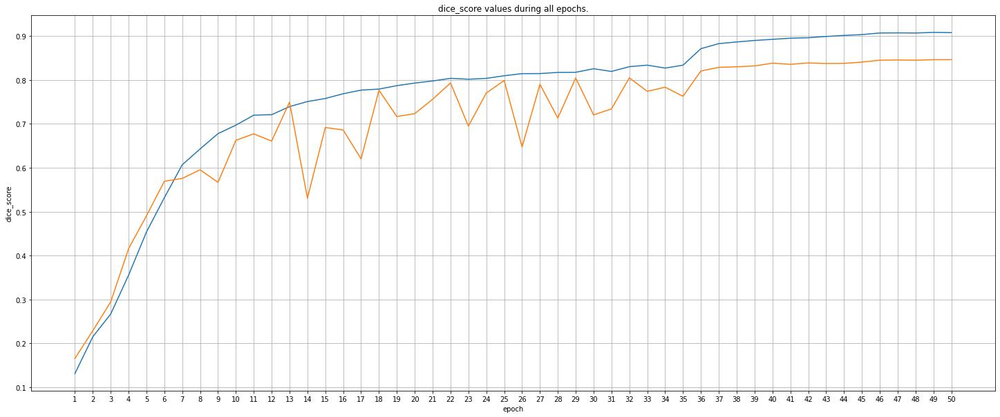

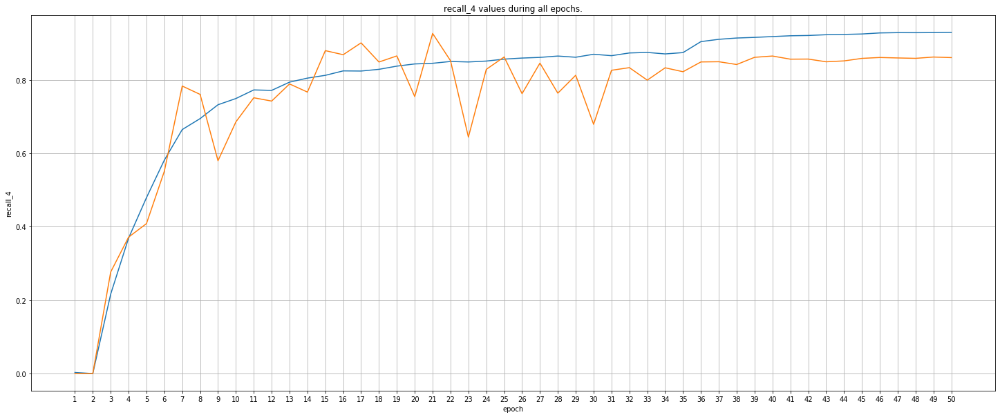

In [58]:
plot_loss_and_metrics(history_modified_u_net_ext_data, "loss")
plot_loss_and_metrics(history_modified_u_net_ext_data, "dice_score")
plot_loss_and_metrics(history_modified_u_net_ext_data, "recall_4")

From plots above we can see that this helped for reducing variance and keep bias the same. Model trained with this data return much better results so this will be our final model which will be used.

### 6. Predicting masks and plotting the results from both architectures.

We can just plot predictions for masks and use $0.5$ value as border to determine the class of the current pixel but let's determine this border so number of false negative and false positive predictions to be minimum.

In [59]:
# predict masks for images from validation set
prediction_modified_u_net_ext_data = modified_u_net_ext_data.predict(validation_images)

# determine coordinates of pixels belonging to tumors
mask_num_p, height_p, width_p = np.where(validation_masks[:, :, :, 0] == 1)
probabilities_modified_u_net_ext_data_p = prediction_modified_u_net_ext_data[mask_num_p, height_p, width_p]

# determine coordinates of pixels which are not part from tumors
mask_num_n, height_n, width_n = np.where(validation_masks[:, :, :, 0] == 0)
probabilities_modified_u_net_ext_data_n = prediction_modified_u_net_ext_data[mask_num_n, height_n, width_n]

# define empty list for sum of number of false negative and false positive predictions
fn_plus_fp_results = []

# define borders for which will be calculated number of false negative and false positive predictions
border_values = np.arange(0, 1, 0.01)

# calculate number of false negative and false positive predictions and add result to list defined above
for current_border in border_values:
    fn_num = np.count_nonzero(probabilities_modified_u_net_ext_data_p < current_border)
    fp_num = np.count_nonzero(probabilities_modified_u_net_ext_data_n > current_border)
    fn_plus_fp_results.append(fn_num + fp_num)

# find border for which sum of false negative and false positive predictions will be minimum
true_false_border = border_values[fn_plus_fp_results.index(min(fn_plus_fp_results))]

Once the border which will determine current prediction like part of the tumor or not is deffined we can plot MRI images, real masks and predicted from the model masks for testing set.

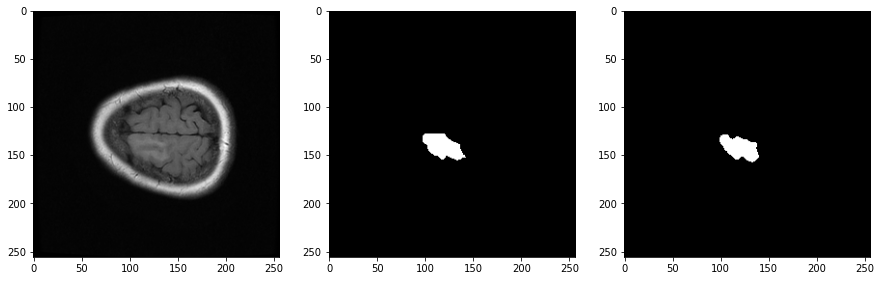

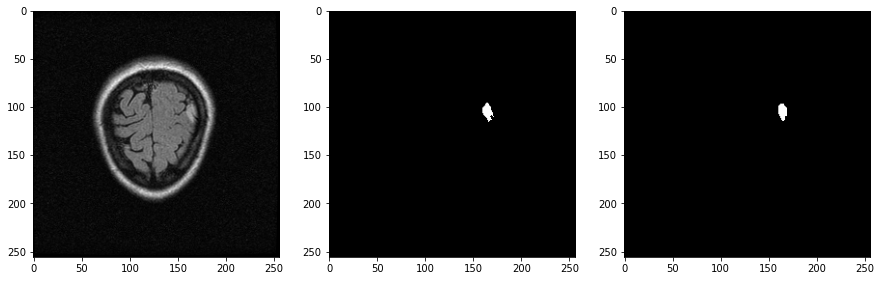

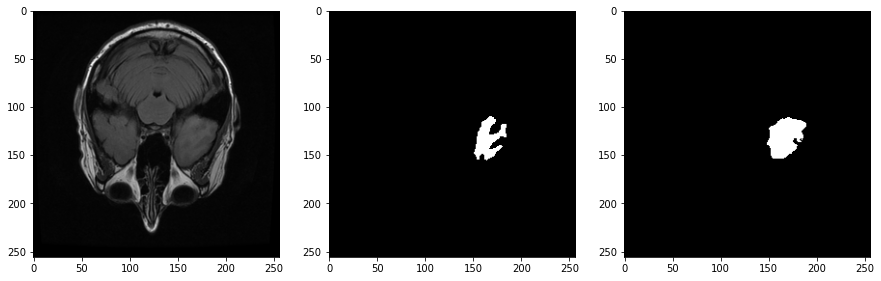

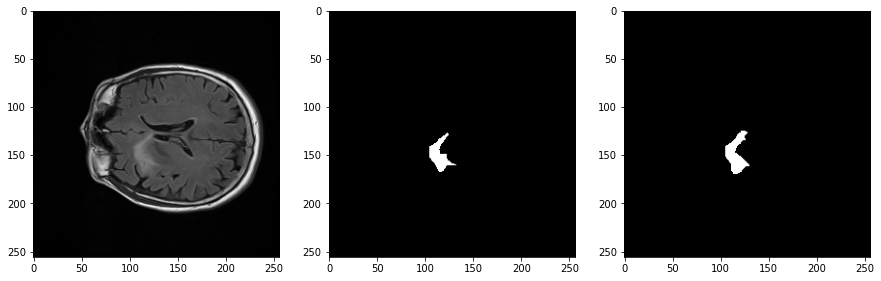

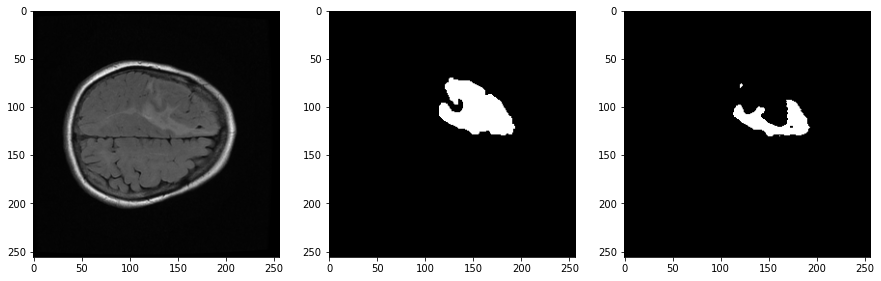

...

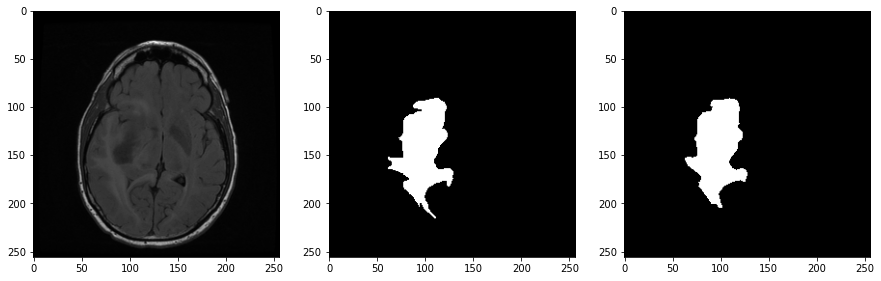

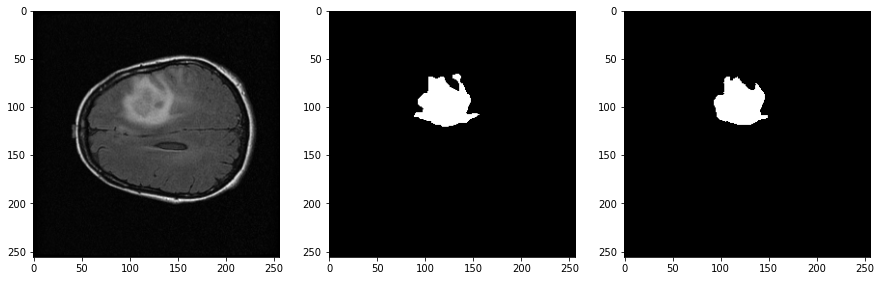

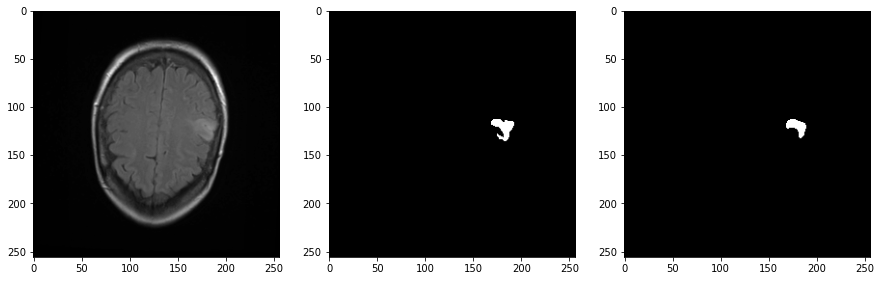

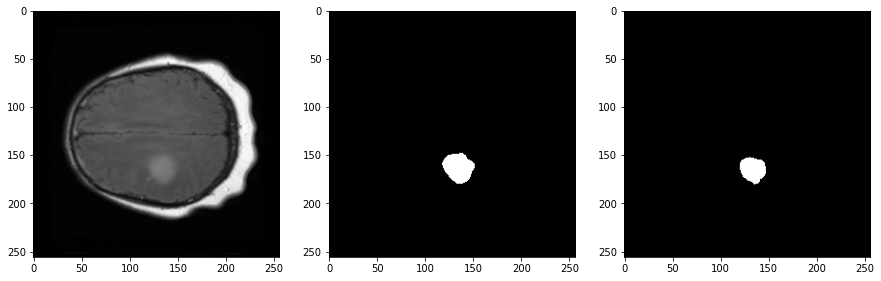

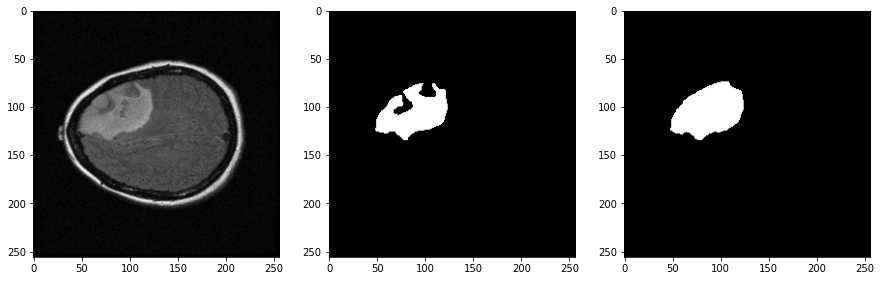

In [60]:
for image_num in range(0, len(test_images)):
    plt.figure(figsize = (15, 15))
    plt.subplot(131)
    plt.imshow(test_images[image_num][:, :, 0], cmap = "gray")
    plt.subplot(132)
    plt.imshow(test_masks[image_num][:, :, 0], cmap = "gray")
    prediction_modified_u_net = modified_u_net.predict(np.array([test_images[image_num]]))
    plt.subplot(133)
    plt.imshow(prediction_modified_u_net[0][:, :, 0] > true_false_border, cmap = "gray")
    plt.show()

## III. Conclusion.

In conclusion we can say that results from modified U-Net model are good but can be better if there is more data for training because regardless of applied transformations to expand the dataset and to make it more diverse there is still images which are similar. If we inspect plotted masks above  we can see that when tumors is clearly visiable we can say that model return correct predictions but for areas where it is not so clearly model is not so sure. Also there is difficulties for small tumors. For these two cases model can be improved if we use more data for testing which will lead to need model to be trained for more than 50 epochs because shapes, densities and sizes of the tumors vary a lot and for model will be harder.

## IV. References.

1. https://braintumor.org/brain-tumor-information/brain-tumor-facts/
2. "U-Net: Convolutional Networks for BiomedicalImage Segmentation"-Olaf Ronneberger, Philipp Fischer, and Thomas Bro
3. https://res.cloudinary.com/practicaldev/image/fetch/s--UxPmOx39--/c_limit%2Cf_auto%2Cfl_progressive%2Cq_auto%2Cw_880/https://thepracticaldev.s3.amazonaws.com/i/6u7xjfpf6fbthhpzu194.png
4. https://keras.io/guides/functional_api/
5. https://www.kaggle.com/naghmehsh/image-segmentation-for-detecting-brain-tumor
6. Taha, A.A., Hanbury, A. Metrics for evaluating 3D medical image segmentation: analysis, selection, and tool. BMC Med Imaging 15, 29 (2015). https://doi.org/10.1186/s12880-015-0068-x
7. https://www.kaggle.com/mateuszbuda/lgg-mri-segmentation